In [200]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import plotly.express as px
import plotly.io as pio


pd.set_option('display.max_columns', None)


pd.set_option('display.expand_frame_repr', False)

In [202]:
df_historic = pd.read_csv('NYPD_Shooting_Incident_Data_(Historic)_20251112.csv')
df_ytd = pd.read_csv('NYPD_Shooting_Incident_Data_(Year_To_Date)_20251112.csv')

df_historic.head(5)

,INCIDENT_KEY,OCCUR_DATE,OCCUR_TIME,BORO,LOC_OF_OCCUR_DESC,PRECINCT,JURISDICTION_CODE,LOC_CLASSFCTN_DESC,LOCATION_DESC,STATISTICAL_MURDER_FLAG,PERP_AGE_GROUP,PERP_SEX,PERP_RACE,VIC_AGE_GROUP,VIC_SEX,VIC_RACE,X_COORD_CD,Y_COORD_CD,Latitude,Longitude,Lon_Lat
0,298699604,12/31/2024,19:16:00,BROOKLYN,OUTSIDE,69,0.0,STREET,(null),False,25-44,M,BLACK,25-44,M,BLACK,"1,015,120","173,870",40.643866,-73.888761,POINT (-73.888761 40.643866)
1,298699604,12/31/2024,19:16:00,BROOKLYN,OUTSIDE,69,0.0,STREET,(null),False,25-44,M,BLACK,18-24,M,BLACK,"1,015,120","173,870",40.643866,-73.888761,POINT (-73.888761 40.643866)
2,298672096,12/30/2024,16:45:00,BRONX,OUTSIDE,47,0.0,STREET,(null),False,(null),(null),(null),<18,F,WHITE HISPANIC,"1,021,316","259,277",40.878261,-73.865964,POINT (-73.865964 40.878261)
3,298672094,12/30/2024,12:15:00,BRONX,OUTSIDE,52,0.0,STREET,(null),False,45-64,M,BLACK,25-44,M,WHITE,"1,017,719","260,875",40.882661,-73.878964,POINT (-73.878964 40.882661)
4,298672095,12/30/2024,20:32:00,BRONX,INSIDE,41,0.0,DWELLING,MULTI DWELL - APT BUILD,True,18-24,M,BLACK,25-44,M,BLACK,"1,012,201","240,878",40.827795,-73.899003,POINT (-73.899003 40.827795)


In [204]:
print(df_historic.dtypes)

INCIDENT_KEY                 int64
OCCUR_DATE                  object
OCCUR_TIME                  object
BORO                        object
LOC_OF_OCCUR_DESC           object
PRECINCT                     int64
JURISDICTION_CODE          float64
LOC_CLASSFCTN_DESC          object
LOCATION_DESC               object
STATISTICAL_MURDER_FLAG       bool
PERP_AGE_GROUP              object
PERP_SEX                    object
PERP_RACE                   object
VIC_AGE_GROUP               object
VIC_SEX                     object
VIC_RACE                    object
X_COORD_CD                  object
Y_COORD_CD                  object
Latitude                   float64
Longitude                  float64
Lon_Lat                     object
dtype: object


In [206]:
df_ytd.head(5)

,INCIDENT_KEY,OCCUR_DATE,OCCUR_TIME,BORO,LOC_OF_OCCUR_DESC,PRECINCT,JURISDICTION_CODE,LOC_CLASSFCTN_DESC,LOCATION_DESC,STATISTICAL_MURDER_FLAG,PERP_AGE_GROUP,PERP_SEX,PERP_RACE,VIC_AGE_GROUP,VIC_SEX,VIC_RACE,X_COORD_CD,Y_COORD_CD,Latitude,Longitude,New Georeferenced Column
0,308408221,06/20/2025,19:06:00,QUEENS,OUTSIDE,104,0,STREET,(null),N,25-44,M,WHITE HISPANIC,25-44,M,BLACK,"1,013,701","195,936",0.000000,0.000000,POINT (0 0)
1,306062049,05/08/2025,00:25:00,BRONX,OUTSIDE,47,2,HOUSING,MULTI DWELL - PUBLIC HOUS,N,(null),(null),(null),25-44,M,WHITE HISPANIC,"1,030,360","261,043",40.883065,-73.833249,POINT (-73.833249 40.883065)
2,312202110,09/01/2025,19:34:00,BRONX,OUTSIDE,49,0,STREET,(null),N,18-24,M,BLACK,18-24,M,BLACK,"1,020,797","254,600",40.865427,-73.867866,POINT (-73.867866 40.865427)
3,312957372,09/15/2025,17:32:00,MANHATTAN,OUTSIDE,25,0,STREET,(null),N,18-24,M,BLACK,<18,M,BLACK,"1,002,444","231,358",40.801690,-73.934282,POINT (-73.934282 40.80169)
4,311949658,08/26/2025,15:30:00,BRONX,OUTSIDE,48,0,STREET,(null),N,25-44,M,BLACK,25-44,M,BLACK,"1,014,898","249,845",40.852399,-73.889217,POINT (-73.889217 40.852399)


In [208]:
print(df_ytd.dtypes)

INCIDENT_KEY                  int64
OCCUR_DATE                   object
OCCUR_TIME                   object
BORO                         object
LOC_OF_OCCUR_DESC            object
PRECINCT                      int64
JURISDICTION_CODE             int64
LOC_CLASSFCTN_DESC           object
LOCATION_DESC                object
STATISTICAL_MURDER_FLAG      object
PERP_AGE_GROUP               object
PERP_SEX                     object
PERP_RACE                    object
VIC_AGE_GROUP                object
VIC_SEX                      object
VIC_RACE                     object
X_COORD_CD                   object
Y_COORD_CD                   object
Latitude                    float64
Longitude                   float64
New Georeferenced Column     object
dtype: object


In [210]:
print(df_historic.shape)

(29744, 21)


In [212]:
print(df_ytd.shape)

(769, 21)


#### 

In [215]:
# Basic append - keeps all rows from both datasets
# DATETIME COLUMN
df_combined = pd.concat([df_ytd, df_historic], ignore_index=True)
df_combined['datetime'] = pd.to_datetime(
    df_combined['OCCUR_DATE'].astype(str) + ' ' + df_combined['OCCUR_TIME'].astype(str)
)
# changing some of the columns to look at the data correclty. 

In [217]:
df_combined.head(5)
# it does not show "PERP_AGE_GROUP" and	"PERP_SEX"

,INCIDENT_KEY,OCCUR_DATE,OCCUR_TIME,BORO,LOC_OF_OCCUR_DESC,PRECINCT,JURISDICTION_CODE,LOC_CLASSFCTN_DESC,LOCATION_DESC,STATISTICAL_MURDER_FLAG,PERP_AGE_GROUP,PERP_SEX,PERP_RACE,VIC_AGE_GROUP,VIC_SEX,VIC_RACE,X_COORD_CD,Y_COORD_CD,Latitude,Longitude,New Georeferenced Column,Lon_Lat,datetime
0,308408221,06/20/2025,19:06:00,QUEENS,OUTSIDE,104,0.0,STREET,(null),N,25-44,M,WHITE HISPANIC,25-44,M,BLACK,"1,013,701","195,936",0.000000,0.000000,POINT (0 0),NaN,2025-06-20 19:06:00
1,306062049,05/08/2025,00:25:00,BRONX,OUTSIDE,47,2.0,HOUSING,MULTI DWELL - PUBLIC HOUS,N,(null),(null),(null),25-44,M,WHITE HISPANIC,"1,030,360","261,043",40.883065,-73.833249,POINT (-73.833249 40.883065),NaN,2025-05-08 00:25:00
2,312202110,09/01/2025,19:34:00,BRONX,OUTSIDE,49,0.0,STREET,(null),N,18-24,M,BLACK,18-24,M,BLACK,"1,020,797","254,600",40.865427,-73.867866,POINT (-73.867866 40.865427),NaN,2025-09-01 19:34:00
3,312957372,09/15/2025,17:32:00,MANHATTAN,OUTSIDE,25,0.0,STREET,(null),N,18-24,M,BLACK,<18,M,BLACK,"1,002,444","231,358",40.801690,-73.934282,POINT (-73.934282 40.80169),NaN,2025-09-15 17:32:00
4,311949658,08/26/2025,15:30:00,BRONX,OUTSIDE,48,0.0,STREET,(null),N,25-44,M,BLACK,25-44,M,BLACK,"1,014,898","249,845",40.852399,-73.889217,POINT (-73.889217 40.852399),NaN,2025-08-26 15:30:00


In [219]:
### print("VALUE COUNTS FOR SOME CATEGORICAL COLUMNS:")
categorical_df = df_combined[['BORO', 'LOC_OF_OCCUR_DESC', 'PRECINCT', 'LOC_CLASSFCTN_DESC', 'LOCATION_DESC']]

for column in categorical_df.select_dtypes(include=['object', 'category']).columns:
    print(f"\n{column}:")
    print(categorical_df[column].value_counts().head(10))  # Top 10 values
    print("-" * 30)

# BORO
# TOTAL=30513
# BK 39.2%, BX 30.0%, QU 14.8%, MA 13.4%, SI 2.7%

# LOC OCCUR
# outside 13.6%
# inside 2.5%
# null = 83.9%

# LOC CLASSFCTN
# blank 83.8%, street 10.3%, housing 2.6%, dwelling 1.3%, commercial 1.1%, playground 0.3%, other 0.3%, transit 0.2%, vehicle 0.1%, parking lot 0%, null 0%


BORO:
BORO
BROOKLYN         11951
BRONX             9132
QUEENS            4512
MANHATTAN         4088
STATEN ISLAND      830
Name: count, dtype: int64
------------------------------

LOC_OF_OCCUR_DESC:
LOC_OF_OCCUR_DESC
OUTSIDE    4158
INSIDE      759
Name: count, dtype: int64
------------------------------

LOC_CLASSFCTN_DESC:
LOC_CLASSFCTN_DESC
STREET         3140
HOUSING         782
DWELLING        390
COMMERCIAL      328
PLAYGROUND       85
OTHER            80
TRANSIT          54
VEHICLE          33
PARKING LOT      16
(null)            9
Name: count, dtype: int64
------------------------------

LOCATION_DESC:
LOCATION_DESC
MULTI DWELL - PUBLIC HOUS    5316
MULTI DWELL - APT BUILD      3099
(null)                       3040
PVT HOUSE                    1015
GROCERY/BODEGA                789
BAR/NIGHT CLUB                726
COMMERCIAL BLDG               306
RESTAURANT/DINER              218
NONE                          175
FAST FOOD                     131
Name: count, dtype: in

In [221]:
print("VALUE COUNTS FOR PERP & VIC COLUMNS:")
perp_vic_df = df_combined[['PERP_AGE_GROUP', 'PERP_SEX', 'PERP_RACE', 'VIC_AGE_GROUP', 'VIC_SEX', 'VIC_RACE']]

for column in perp_vic_df.select_dtypes(include=['object', 'category']).columns:
    print(f"\n{column}:")
    print(perp_vic_df[column].value_counts().head(10))  # Top 10 values
    print("-" * 30)

# PERP AGE: BLANK 30.6% | 18-24 22.2% | 25-44 21.5% | UNK 10.3% | <18 6.2% | NULL 6.2% | 45-64 2.7%
# PERP SEX: M 56.8% | BLANK 30.5% | NULL 6.2% | U 4.9% | F 1.6%
# PERP RACE: BLACK 41.6% | BLANK 30.7% | WHITE HISP 9.1% | NULL 6.0% | UNK 6.0% | BLACK HIS 5.0% | WHITE 1.0% | ASIAN 0.6%
# VIC AGE: 25-44 45.7%| 18-24 35.6% | <18 10.4% | 45-64 7.2% | 65+ 0.8%| UNK 0.2%| OTHER 0.1%
# VIC SEX: M 90.1%| F  9.8% | OTHER 0.0%
# VIC RACE: BLACK 70.6% | WHITE HISP 15.2% | BLACK HIS 9.8% | WHITE 2.5% | ASIAN 1.6%

VALUE COUNTS FOR PERP & VIC COLUMNS:

PERP_AGE_GROUP:
PERP_AGE_GROUP
18-24      6789
25-44      6555
UNKNOWN    3148
<18        1892
(null)     1891
45-64       816
65+          73
2021          1
1028          1
1020          1
Name: count, dtype: int64
------------------------------

PERP_SEX:
PERP_SEX
M         17339
(null)     1891
U          1500
F           473
Name: count, dtype: int64
------------------------------

PERP_RACE:
PERP_RACE
BLACK                             12679
WHITE HISPANIC                     2767
(null)                             1891
UNKNOWN                            1838
BLACK HISPANIC                     1530
WHITE                               307
ASIAN / PACIFIC ISLANDER            189
AMERICAN INDIAN/ALASKAN NATIVE        2
Name: count, dtype: int64
------------------------------

VIC_AGE_GROUP:
VIC_AGE_GROUP
25-44      13950
18-24      10869
<18         3180
45-64       2201
65+          243
UNKNOWN       69
1022           1
Name: count, dtype: int64

In [223]:
daily_counts = df_combined.groupby(df_combined['datetime'].dt.date).size().reset_index()
daily_counts.columns = ['date', 'count']
daily_counts['date'] = pd.to_datetime(daily_counts['date'])

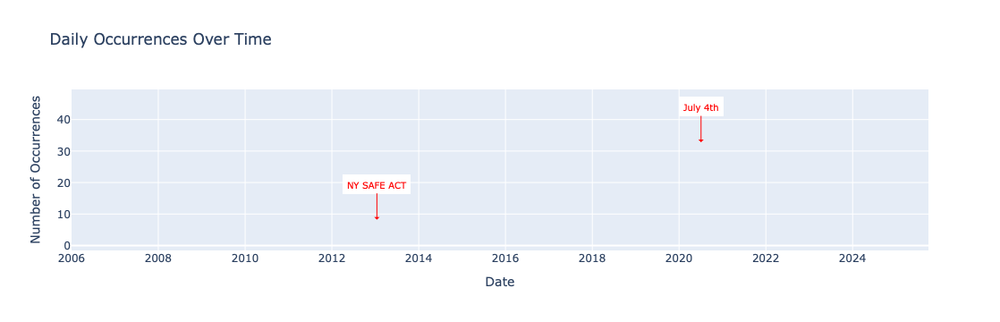

In [225]:
fig1 = px.line(
    daily_counts, 
    x='date', 
    y='count',
    title='Daily Occurrences Over Time',
    labels={'date': 'Date', 'count': 'Number of Occurrences'}
)

# Customize to better see spikes
fig1.update_traces(line=dict(width=2))
fig1.update_layout(
    xaxis=dict(showgrid=True),
    yaxis=dict(showgrid=True),
    hovermode='x unified'
)

# Find the y-value at July 4th
july_4th = pd.Timestamp('2020-07-04')
# Get the count value on that date
try:
    y_value = daily_counts.loc[daily_counts['date'] == july_4th, 'count'].values[0]
except:
    # If exact date not found, use max value
    y_value = daily_counts['count'].max()

# Add a marker/annotation only
fig1.add_annotation(
    x=july_4th,
    y=y_value * 4.1,  # Position above the data point
    text="July 4th",
    showarrow=True,
    arrowhead=1,
    arrowsize=1,
    arrowwidth=1,
    arrowcolor="red",
    font=dict(size=10, color="red"),
    bgcolor="white",
    bordercolor="white",
    borderwidth=1,
    borderpad=4,
    ax=0,  # Arrow x-offset
    ay=-40  # Arrow y-offset (negative = down)
)

# Find the y-value at January 14 2013. NY SAFE ACT - a month After Sandy hook shooting.
jan_14 = pd.Timestamp('2013-01-14')
# Get the count value on that date
try:
    y_value = daily_counts.loc[daily_counts['date'] == jan_14, 'count'].values[0]
except:
    # If exact date not found, use max value
    y_value = daily_counts['count'].max()

# Add a marker/annotation only
fig1.add_annotation(
    x=jan_14,
    y=y_value * 4.1,  # Position above the data point
    text="NY SAFE ACT",
    showarrow=True,
    arrowhead=1,
    arrowsize=1,
    arrowwidth=1,
    arrowcolor="red",
    font=dict(size=10, color="red"),
    bgcolor="white",
    bordercolor="white",
    borderwidth=1,
    borderpad=4,
    ax=0,  # Arrow x-offset
    ay=-40  # Arrow y-offset (negative = down)
)


html_str1 = pio.to_html(fig1,
        full_html=False, 
        include_plotlyjs='cdn')
'''with open("assets/plots/plot1.html",
"w")
as f: f.write(html_str)'''


fig1.show()

fig1.write_html("Daily_OT.html")

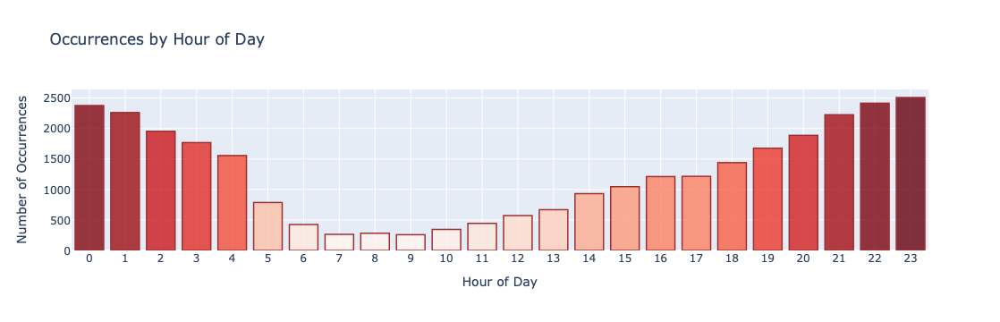

In [226]:
# Extract hour from datetime
df_combined['hour'] = df_combined['datetime'].dt.hour

# Group by hour to count occurrences per hour
hourly_counts = df_combined.groupby('hour').size().reset_index()
hourly_counts.columns = ['hour', 'count']

# Create hourly BAR chart (vertical)
fig2 = px.bar(
    hourly_counts, 
    x='hour', 
    y='count',
    title='Occurrences by Hour of Day',
    labels={'hour': 'Hour of Day', 'count': 'Number of Occurrences'},
    color='count',  # Optional: color bars by count
    color_continuous_scale='Reds'  # Red color scale
)

# Customize for better visualization
fig2.update_layout(
    xaxis=dict(
        tickmode='linear',
        dtick=1,
        showgrid=True,
        title='Hour of Day'
    ),
    yaxis=dict(
        showgrid=True,
        title='Number of Occurrences'
    ),
    coloraxis_showscale=False  # Hide color scale if not needed
)

# Customize bar appearance
fig2.update_traces(
    marker_line_color='darkred',
    marker_line_width=1.5,
    opacity=0.8
)


html_str2 = pio.to_html(fig2,
        full_html=False, 
        include_plotlyjs='cdn')
'''with open("assets/plots/plot3.html",
"w")
as f: f.write(html_str)'''


fig2.show()

fig2.write_html("Hour_of_Day.html")

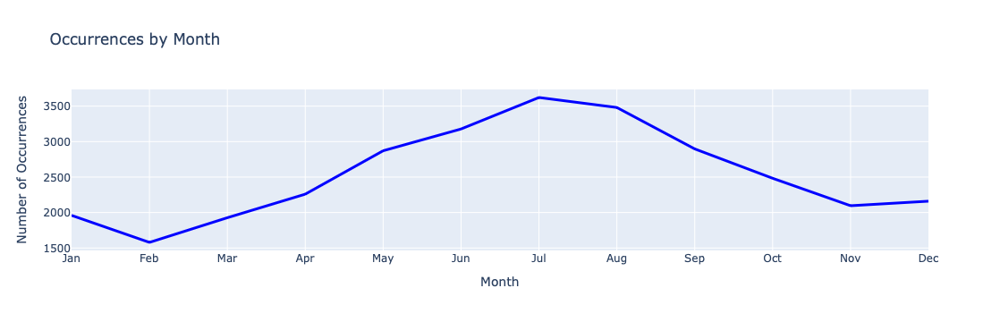

In [231]:
# Extract month from datetime
df_combined['month'] = df_combined['datetime'].dt.month

# Group by month to count occurrences per month
monthly_counts = df_combined.groupby('month').size().reset_index()
monthly_counts.columns = ['month', 'count']

# Sort by month
monthly_counts = monthly_counts.sort_values('month')

# Create monthly line chart
fig3 = px.line(
    monthly_counts, 
    x='month', 
    y='count',
    title='Occurrences by Month',
    labels={'month': 'Month', 'count': 'Number of Occurrences'}
)

# Customize for better visualization
fig3.update_traces(
    line=dict(width=3, color='blue'),
    marker=dict(size=8, color='darkblue')
)

fig3.update_layout(
    xaxis=dict(
        tickmode='array',
        tickvals=list(range(1, 13)),
        ticktext=['Jan', 'Feb', 'Mar', 'Apr', 'May', 'Jun', 
                 'Jul', 'Aug', 'Sep', 'Oct', 'Nov', 'Dec'],
        showgrid=True
    ),
    yaxis=dict(showgrid=True)
)


html_str3 = pio.to_html(fig3,
        full_html=False, 
        include_plotlyjs='cdn')
'''with open("assets/plots/plot3.html",
"w")
as f: f.write(html_str)'''


fig3.show()

fig3.write_html("Occur_by_month.html")

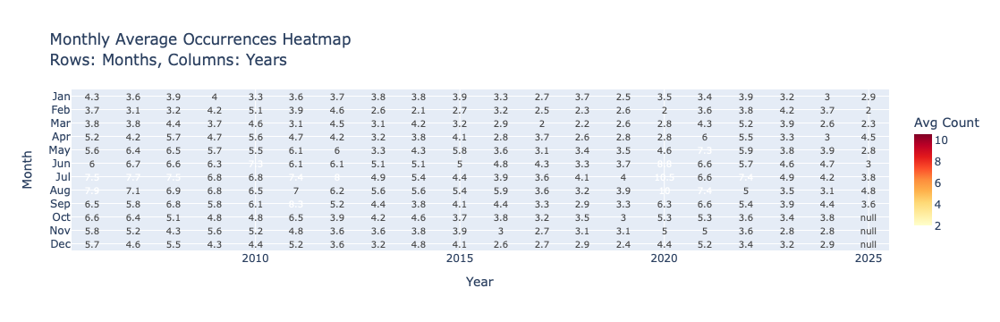

In [234]:
# Extract year and month
df_combined['year'] = df_combined['datetime'].dt.year
df_combined['month'] = df_combined['datetime'].dt.month
df_combined['month_name'] = df_combined['datetime'].dt.strftime('%b')

# Group by year and month, calculate average count per month
# First, let's get daily counts if you don't have them already
df_combined['date'] = df_combined['datetime'].dt.date
daily_avg = df_combined.groupby(['year', 'month', 'month_name', 'date']).size().reset_index()
daily_avg.columns = ['year', 'month', 'month_name', 'date', 'daily_count']

# Now calculate monthly average from daily counts
monthly_avg = daily_avg.groupby(['year', 'month', 'month_name']).agg({
    'daily_count': 'mean'
}).reset_index()

monthly_avg = monthly_avg.rename(columns={'daily_count': 'monthly_avg'})

# Create pivot table for heatmap
pivot_table = monthly_avg.pivot_table(
    index='month_name', 
    columns='year', 
    values='monthly_avg', 
    aggfunc='mean'
)

# Ensure months are in correct order
month_order = ['Jan', 'Feb', 'Mar', 'Apr', 'May', 'Jun', 
               'Jul', 'Aug', 'Sep', 'Oct', 'Nov', 'Dec']
pivot_table = pivot_table.reindex(index=month_order)

# Create heatmap
fig_heatmap = px.imshow(
    pivot_table,
    title='Monthly Average Occurrences Heatmap<br>Rows: Months, Columns: Years',
    labels=dict(x="Year", y="Month", color="Average Count"),
    color_continuous_scale='YlOrRd',
    aspect='auto'  # Adjust aspect ratio
)

# Customize layout
fig_heatmap.update_layout(
    xaxis=dict(
        side='bottom',
        tickangle=0,
        title='Year'
    ),
    yaxis=dict(
        title='Month',
        tickmode='array',
        tickvals=list(range(len(month_order))),
        ticktext=month_order
    ),
    coloraxis_colorbar=dict(
        title="Avg Count",
        thickness=20,
        len=0.8
    )
)

# Add text annotations on heatmap cells
fig_heatmap.update_traces(
    text=np.round(pivot_table.values, 1),
    texttemplate="%{text}",
    textfont={"size": 10}
)



html_str4 = pio.to_html(fig_heatmap,
        full_html=False, 
        include_plotlyjs='cdn')
'''with open("assets/plots/plot4.html",
"w")
as f: f.write(html_str)'''


fig_heatmap.show()

fig_heatmap.write_html("Heatmap.html")

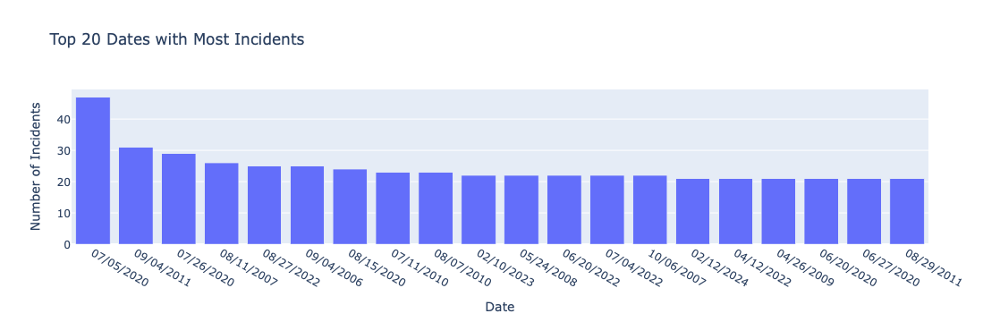

In [236]:
# columns that could be analyzed more: boro, Vic sex, age, race, datetime
# columns with problems: the perp data has 30% missing values.

# Get top 50 dates with most incidents
top_20_dates = df_combined.groupby('OCCUR_DATE').size().nlargest(20)

# Create bar chart
fig5 = px.bar(
    x=top_20_dates.index,
    y=top_20_dates.values,
    title='Top 20 Dates with Most Incidents',
    labels={'x': 'Date', 'y': 'Number of Incidents'}
)


html_str5 = pio.to_html(fig5,
        full_html=False, 
        include_plotlyjs='cdn')
'''with open("assets/plots/plot5.html",
"w")
as f: f.write(html_str)'''


fig5.show()

fig5.write_html("Dates_Most_Incidents.html")


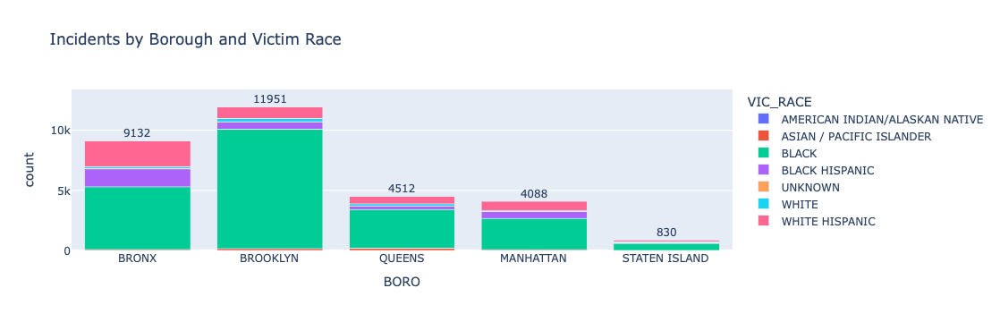

In [238]:
boro_race_counts = df_combined.groupby(['BORO', 'VIC_RACE']).size().reset_index(name='count')

boro_totals = df_combined.groupby('BORO').size().reset_index(name='total')


fig6 = px.bar(
    boro_race_counts,
    x='BORO',
    y='count',
    color='VIC_RACE',
    title='Incidents by Borough and Victim Race'
)

for i, total in enumerate(boro_totals['total']):
    fig6.add_annotation(
        x=boro_totals['BORO'].iloc[i],
        y=total,
        text=str(total),
        showarrow=False,
        yshift=10
    )
    
html_str6 = pio.to_html(fig6,
        full_html=False, 
        include_plotlyjs='cdn')
'''with open("assets/plots/plot6.html",
"w")
as f: f.write(html_str)'''


fig6.show()

fig6.write_html("By_Borough_Vic_Race.html")

In [115]:
print(df_combined.shape)
print(df_ytd.shape)
print(df_historic.shape)

(30513, 28)
(769, 21)
(29744, 21)


In [117]:
df_combined.describe(include='all')

,INCIDENT_KEY,OCCUR_DATE,OCCUR_TIME,BORO,LOC_OF_OCCUR_DESC,PRECINCT,JURISDICTION_CODE,LOC_CLASSFCTN_DESC,LOCATION_DESC,STATISTICAL_MURDER_FLAG,PERP_AGE_GROUP,PERP_SEX,PERP_RACE,VIC_AGE_GROUP,VIC_SEX,VIC_RACE,X_COORD_CD,Y_COORD_CD,Latitude,Longitude,New Georeferenced Column,Lon_Lat,datetime,hour,month,year,month_name,date
count,3.051300e+04,30513,30513,30513,4917,30513.000000,30511.000000,4917,15536,30513,21169,21203,21203,30513,30513,30513,30513,30513,30416.000000,30416.000000,769,29647,30513,30513.000000,30513.000000,30513.000000,30513,30513
unique,NaN,6663,1623,5,2,NaN,NaN,10,40,4,12,4,8,7,4,7,14353,14511,NaN,NaN,525,14057,NaN,NaN,NaN,NaN,12,6663
top,NaN,07/05/2020,23:30:00,BROOKLYN,OUTSIDE,NaN,NaN,STREET,MULTI DWELL - PUBLIC HOUS,False,18-24,M,BLACK,25-44,M,BLACK,1017119.437500000000000,183909.343750000000000,NaN,NaN,POINT (-73.959087 40.66759),POINT (-73.88151014499994 40.67141260500006),NaN,NaN,NaN,NaN,Jul,2020-07-05
freq,NaN,47,196,11951,4158,NaN,NaN,3140,5316,23979,6789,17339,12679,13950,27504,21529,66,66,NaN,NaN,16,66,NaN,NaN,NaN,NaN,3622,47
mean,1.382225e+08,NaN,NaN,NaN,NaN,65.091469,0.317525,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,40.725204,-73.882265,NaN,NaN,2015-02-06 12:41:07.202831616,12.332022,6.765608,2014.579032,NaN,NaN
min,9.953245e+06,NaN,NaN,NaN,NaN,1.000000,0.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.000000,-74.249303,NaN,NaN,2006-01-01 02:00:00,0.000000,1.000000,2006.000000,NaN,NaN
25%,6.860981e+07,NaN,NaN,NaN,NaN,44.000000,0.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,40.669077,-73.942750,NaN,NaN,2009-12-07 17:23:00,3.000000,4.000000,2009.000000,NaN,NaN
50%,1.374710e+08,NaN,NaN,NaN,NaN,67.000000,0.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,40.703706,-73.914743,NaN,NaN,2014-06-26 22:51:00,15.000000,7.000000,2014.000000,NaN,NaN
75%,2.169727e+08,NaN,NaN,NaN,NaN,81.000000,0.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,40.825735,-73.882582,NaN,NaN,2020-08-24 00:18:00,20.000000,9.000000,2020.000000,NaN,NaN
max,3.137164e+08,NaN,NaN,NaN,NaN,123.000000,2.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,40.910818,0.000000,NaN,NaN,2025-09-30 17:56:00,23.000000,12.000000,2025.000000,NaN,NaN


Total unique combinations: 73
Total shootings represented: 30,513


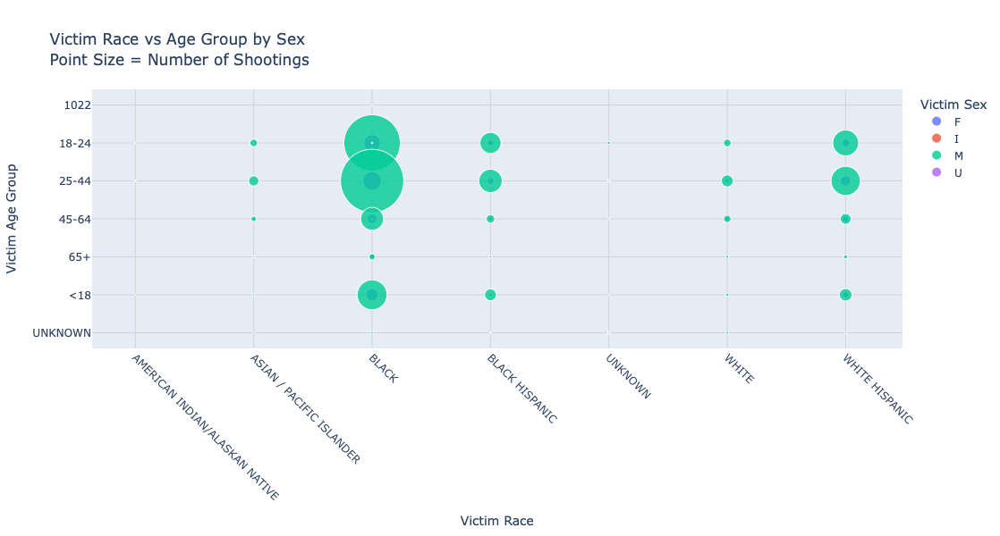


SUMMARY STATISTICS

Top 10 Most Common Victim Race/Age/Sex Combinations:
21. Race: BLACK, Age: 25-44, Sex: M: 9,039 shootings
18. Race: BLACK, Age: 18-24, Sex: M: 7,193 shootings
28. Race: BLACK, Age: <18, Sex: M: 2,013 shootings
65. Race: WHITE HISPANIC, Age: 25-44, Sex: M: 1,925 shootings
63. Race: WHITE HISPANIC, Age: 18-24, Sex: M: 1,505 shootings
34. Race: BLACK HISPANIC, Age: 25-44, Sex: M: 1,229 shootings
24. Race: BLACK, Age: 45-64, Sex: M: 1,182 shootings
32. Race: BLACK HISPANIC, Age: 18-24, Sex: M: 1,005 shootings
20. Race: BLACK, Age: 25-44, Sex: F: 766 shootings
17. Race: BLACK, Age: 18-24, Sex: F: 628 shootings

Most Common Victim Race by Sex:
• F: BLACK (1,991 victims)
• I: BLACK (1 victims)
• M: BLACK (19,533 victims)
• U: UNKNOWN (8 victims)

Most Common Age Group by Victim Sex:
• F: 25-44 (1,183 victims)
• I: 45-64 (1 victims)
• M: 25-44 (12,765 victims)
• U: UNKNOWN (6 victims)

Sex Distribution by Victim Race:

AMERICAN INDIAN/ALASKAN NATIVE:
  • F: 1 (7.1%)
  • M:

In [240]:
# Clean the data - handle missing values
df_clean = df_combined.dropna(subset=['VIC_RACE', 'VIC_AGE_GROUP', 'VIC_SEX']).copy()

# Count occurrences for each combination
group_counts = df_clean.groupby(['VIC_RACE', 'VIC_AGE_GROUP', 'VIC_SEX']).size().reset_index(name='count')

print(f"Total unique combinations: {len(group_counts)}")
print(f"Total shootings represented: {group_counts['count'].sum():,}")

# Create the scatter plot
fig = px.scatter(
    group_counts,
    x='VIC_RACE',          # X-axis: Victim Race
    y='VIC_AGE_GROUP',     # Y-axis: Victim Age Group
    size='count',          # Point size: Number of shootings
    color='VIC_SEX',       # Legend/Color: Victim Sex
    hover_name='VIC_SEX',
    hover_data={
        'VIC_RACE': True,
        'VIC_AGE_GROUP': True,
        'VIC_SEX': False,  # Already in hover_name
        'count': True
    },
    title='Victim Race vs Age Group by Sex<br>Point Size = Number of Shootings',
    labels={
        'VIC_RACE': 'Victim Race',
        'VIC_AGE_GROUP': 'Victim Age Group',
        'VIC_SEX': 'Victim Sex',
        'count': 'Number of Shootings'
    },
    size_max=50,
    opacity=0.8,
    category_orders={
        'VIC_RACE': sorted(group_counts['VIC_RACE'].unique()),
        'VIC_AGE_GROUP': sorted(group_counts['VIC_AGE_GROUP'].unique()),
        'VIC_SEX': sorted(group_counts['VIC_SEX'].unique())
    }
)

# Customize layout
fig.update_layout(
    xaxis=dict(
        title='Victim Race',
        showgrid=True,
        tickangle=45
    ),
    yaxis=dict(
        title='Victim Age Group',
        showgrid=True
    ),
    legend=dict(
        title='Victim Sex',
        yanchor="top",
        y=0.99,
        xanchor="left",
        x=1.02,
        itemsizing='constant'
    ),
    height=600,
    width=1000,
    hovermode='closest'
)

# Add a grid for better readability
fig.update_xaxes(showgrid=True, gridwidth=1, gridcolor='lightgray')
fig.update_yaxes(showgrid=True, gridwidth=1, gridcolor='lightgray')

html_str7 = pio.to_html(fig,
        full_html=False, 
        include_plotlyjs='cdn')
'''with open("assets/plots/plot7.html",
"w")
as f: f.write(html_str)'''


fig.show()

fig.write_html("Vic_Sex_Age_Race.html")


# Print summary statistics
print("\n" + "="*60)
print("SUMMARY STATISTICS")
print("="*60)

# Top combinations overall
print("\nTop 10 Most Common Victim Race/Age/Sex Combinations:")
top_combinations = group_counts.sort_values('count', ascending=False).head(10)
for idx, row in top_combinations.iterrows():
    print(f"{idx+1}. Race: {row['VIC_RACE']}, Age: {row['VIC_AGE_GROUP']}, Sex: {row['VIC_SEX']}: {row['count']:,} shootings")

# Race distribution by sex
print("\nMost Common Victim Race by Sex:")
for sex in sorted(group_counts['VIC_SEX'].unique()):
    sex_data = group_counts[group_counts['VIC_SEX'] == sex]
    if not sex_data.empty:
        # Find the most common race for this sex
        race_counts = sex_data.groupby('VIC_RACE')['count'].sum().reset_index()
        top_race = race_counts.loc[race_counts['count'].idxmax()]
        print(f"• {sex}: {top_race['VIC_RACE']} ({top_race['count']:,} victims)")

# Age group distribution by sex
print("\nMost Common Age Group by Victim Sex:")
for sex in sorted(group_counts['VIC_SEX'].unique()):
    sex_data = group_counts[group_counts['VIC_SEX'] == sex]
    if not sex_data.empty:
        age_counts = sex_data.groupby('VIC_AGE_GROUP')['count'].sum().reset_index()
        top_age = age_counts.loc[age_counts['count'].idxmax()]
        print(f"• {sex}: {top_age['VIC_AGE_GROUP']} ({top_age['count']:,} victims)")

# Sex distribution by race
print("\nSex Distribution by Victim Race:")
for race in sorted(group_counts['VIC_RACE'].unique()):
    race_data = group_counts[group_counts['VIC_RACE'] == race]
    if not race_data.empty:
        sex_counts = race_data.groupby('VIC_SEX')['count'].sum().reset_index()
        print(f"\n{race}:")
        total_race = sex_counts['count'].sum()
        for _, row in sex_counts.iterrows():
            percentage = (row['count'] / total_race) * 100
            print(f"  • {row['VIC_SEX']}: {row['count']:,} ({percentage:.1f}%)")

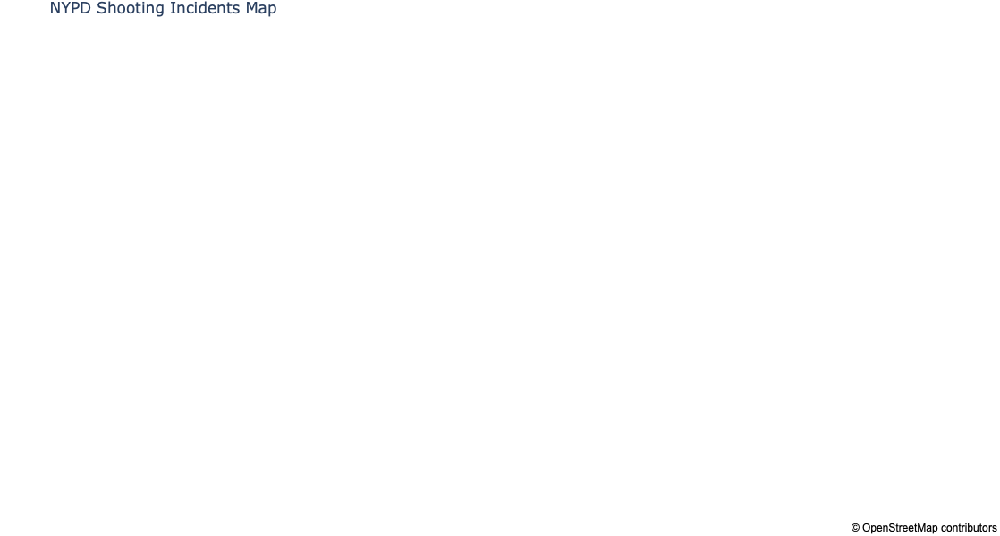

In [242]:
import plotly.express as px
import plotly.graph_objects as go

# Create a basic scatter map
fig8 = px.scatter_mapbox(df_combined,
                        lat='Latitude',
                        lon='Longitude',
                        hover_name='LOCATION_DESC',
                        hover_data={
                            'OCCUR_DATE': True,
                            'BORO': True,
                            'PERP_AGE_GROUP': True,
                            'PERP_RACE': True,
                            'VIC_AGE_GROUP': True,
                            'VIC_RACE': True,
                            'Latitude': False,
                            'Longitude': False
                        },
                        zoom=10,
                        height=600,
                        title='NYPD Shooting Incidents Map')

# Update the map layout
fig8.update_layout(mapbox_style="open-street-map")  # You can change this to other styles
fig8.update_layout(margin={"r":0,"t":30,"l":0,"b":0})

html_str9 = pio.to_html(fig8,
        full_html=False, 
        include_plotlyjs='cdn')
'''with open("assets/plots/plot9.html",
"w")
as f: f.write(html_str)'''


fig8.show()

fig8.write_html("Map_all.html")

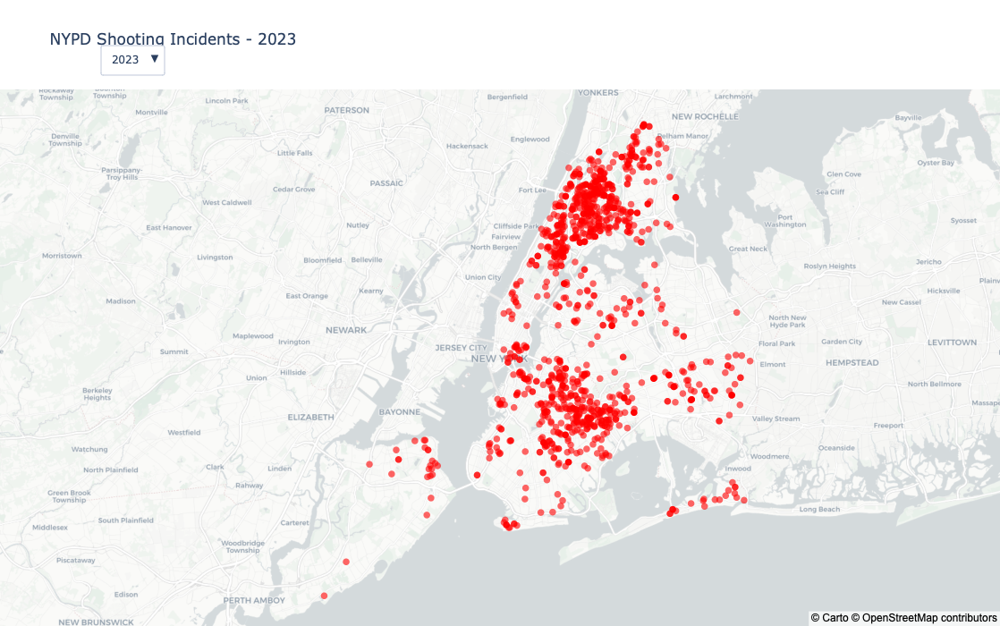

In [244]:
import plotly.graph_objects as go
import pandas as pd

# Extract year
df_combined['YEAR'] = pd.to_datetime(df_combined['OCCUR_DATE']).dt.year
df_filtered = df_combined[(df_combined['YEAR'] >= 2006) & (df_combined['YEAR'] <= 2025)]

# Create a base figure
fig = go.Figure()

# Add a trace for each year (initially all hidden)
years = sorted(df_filtered['YEAR'].unique())

for i, year in enumerate(years):
    df_year = df_filtered[df_filtered['YEAR'] == year]
    
    visible = True if year == 2023 else False  # Show most recent year by default
    
    fig.add_trace(
        go.Scattermapbox(
            lat=df_year['Latitude'],
            lon=df_year['Longitude'],
            mode='markers',
            marker=dict(
                size=8,
                color='red',
                opacity=0.6
            ),
            text=[f"Year: {year}<br>Date: {date}<br>Location: {loc}" 
                  for date, loc in zip(df_year['OCCUR_DATE'], df_year['LOCATION_DESC'])],
            hoverinfo='text',
            name=f'Shootings {year}',
            visible=visible
        )
    )

# Create dropdown buttons
buttons = []

for i, year in enumerate(years):
    visibility = [False] * len(years)
    visibility[i] = True
    
    buttons.append(
        dict(
            label=str(year),
            method="update",
            args=[{"visible": visibility},
                  {"title": f"NYPD Shooting Incidents - {year}"}]
        )
    )

# Update layout with dropdown
fig.update_layout(
    title=f"NYPD Shooting Incidents - 2023",
    mapbox=dict(
        style="carto-positron",
        center=dict(lat=40.7128, lon=-74.0060),
        zoom=9.5,
    ),
    updatemenus=[dict(
        active=years.index(2023) if 2023 in years else 0,
        buttons=buttons,
        direction="down",
        pad={"r": 10, "t": 10},
        showactive=True,
        x=0.1,
        xanchor="left",
        y=1.1,
        yanchor="top"
    )],
    height=700,
    width=1000,
    margin=dict(l=0, r=0, t=100, b=0),
)

html_str10 = pio.to_html(fig,
        full_html=False, 
        include_plotlyjs='cdn')
'''with open("assets/plots/plot10.html",
"w")
as f: f.write(html_str)'''


fig.show()

fig.write_html("Map_per_year.html")

# UX research
 

### Primary: Pratt students (know the tools and can interpret the data easily). 
### Secondary: General Public.  They need an intuitive and engaging story to grasp the complex issue.

### Responses:

### Narrative:  They can understand the story and the narrative.

### Map:  They understood the map but had some questions about the data

### Usability:  They clicked on different points and saw the different information shown. 

### Usability:  With the visuals they needed some instruction on the filtering and zoom functions that plotly has with the notebook.

### Missing Information:  They wish that the analysis would be focused on police surveillance and the relationship with shooting incidents.

### Topics:  They think that the topic is controversial.
